In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Overview
Skin cancer is an abnormal growth of human skin cells that develop on the skin being exposed directly to ultraviolet radiation for an extended period of time. It is one of the most common health issues at a rapidly an alarming rate around the world, with 160,000 medical records reported annually. A significant number of records are in Europe, America, and New Zealand. In contrast, the least reported was in Thailand. Moreover, preventing the chance of developing skin cancer is the aim of this research. In this paper, we presented about to detect skin cancer from images using a Convolutional Neural Network (CNN) in one of the models in Deep Learning. With the PAD-UFES-20 datasets are available from the Federal University of Esprito, Federative Republic of Brazil.

## Data Set
### PAD-UFES-20
**A skin lesion dataset composed of patient data and clinical images collected from smartphones** [(link)](https://doi.org/10.1016/j.dib.2020.106221)  

The PAD-UFES-20 dataset is a comprehensive collection of skin lesion data gathered through the Dermatological and Surgical Assistance Program at the Federal University of Espírito Santo in Brazil. This dataset comprises 2,298 samples representing six distinct types of skin lesions, including both cancerous and non-cancerous conditions. Each sample consists of a clinical image and up to 22 clinical features, providing a rich set of information for analysis [1].

| Diagnostic | Sample | % biopsied |
|------------|---------------|-------------------|
| Actinic Keratosis (ACK) | 730 | 24.4% |
| Basal Cell Carcinoma of skin (BCC) | 845 | 100% |
| Malignant Melanoma (MEL) | 52 | 100% |
| Melanocytic Nevus of Skin (NEV) | 244 | 24.6% |
| Squamous Cell Carcinoma (SCC) | 192 | 100% |
| Seborrheic Keratosis (SEK) | 235 | 6.4% |
| Total | 2298 | 58.4% |

** images: PAD-UFES-20: a skin lesion dataset composed of patient data and clinical images collected from smartphones.zip (3.35 GB)  
** SHA-256 checksum: `e8c7e17bac1698c97e44d4096ec20ac1b91c135285c1446b7b2e7ebbc9be933c`

In [ ]:
!curl -z zr7vgbcyr2-1.zip -O https://prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com/zr7vgbcyr2-1.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 3426M  100 3426M    0     0  25.1M      0  0:02:16  0:02:16 --:--:-- 26.1M


In [ ]:
!unzip -o zr7vgbcyr2-1.zip && find images -name '*.zip' -exec unzip -o -d images {} \; -exec rm {} \; && find images -type f -path '*/imgs_part_*/*' -exec mv {} images/ \; && find images -type d -name 'imgs_part_*' -exec rm -r {} \;

Archive:  zr7vgbcyr2-1.zip
   creating: images/
  inflating: images/imgs_part_2.zip  
  inflating: images/imgs_part_3.zip  
  inflating: images/imgs_part_1.zip  
  inflating: metadata.csv            
Archive:  images/imgs_part_2.zip
   creating: images/imgs_part_2/
  inflating: images/imgs_part_2/PAT_1000_31_620.png  
 extracting: images/imgs_part_2/PAT_1006_53_385.png  
 extracting: images/imgs_part_2/PAT_1006_53_716.png  
  inflating: images/imgs_part_2/PAT_1008_59_297.png  
  inflating: images/imgs_part_2/PAT_1013_82_876.png  
 extracting: images/imgs_part_2/PAT_1014_85_22.png  
  inflating: images/imgs_part_2/PAT_1014_86_861.png  
  inflating: images/imgs_part_2/PAT_1017_97_577.png  
 extracting: images/imgs_part_2/PAT_1018_107_68.png  
  inflating: images/imgs_part_2/PAT_1019_110_194.png  
 extracting: images/imgs_part_2/PAT_1020_111_593.png  
  inflating: images/imgs_part_2/PAT_1021_112_40.png  
  inflating: images/imgs_part_2/PAT_1022_114_756.png  
 extracting: images/imgs_part_

## Skin Cancer Detection from Smartphone Imagery using Convolutional Neural Network

### Setup

Note: Create a virtual environment before running the following commands. (One time setup)

In [ ]:
!python3 -m venv ./venv

In [ ]:
!source .venv/bin/activate

Note: Install the dependencies in the virtual environment

In [ ]:
!pip install --upgrade pip && pip install -r requirements.txt

In [ ]:
import os
import cv2
import itertools
import numpy as np
import pandas as pd
from tqdm import tqdm
from enum import Enum
import tensorflow as tf
from patchify import patchify
import matplotlib.pyplot as plt
from collections import Counter
from tensorflow.keras import backend
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from concurrent.futures import ThreadPoolExecutor
from sklearn.model_selection import train_test_split
from tensorflow.keras.applications import DenseNet121
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import confusion_matrix, classification_report
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import load_img, img_to_array, ImageDataGenerator
from tensorflow.keras.layers import Dense, Flatten, Dropout, Input, Conv2D, MaxPooling2D, concatenate, Conv2DTranspose, Rescaling

Point to the directory where the dataset is stored.

In [ ]:
images_directory = './images/'
labeling_directory = './labeling/'
model_checkpoint = './checkpoint/'
os.makedirs(model_checkpoint, exist_ok=True)

In [ ]:
def get_filenames_without_extension(directory, extension):
    filenames = []
    for filename in os.listdir(directory):
        if os.path.isfile(os.path.join(directory, filename)) and filename.endswith(extension):
            name, _ = os.path.splitext(filename)
            filenames.append(name)
    return filenames

In [ ]:
image_files = get_filenames_without_extension(images_directory, '.png')
target_files = get_filenames_without_extension(labeling_directory, '.tiff')

symmetric = set(image_files).symmetric_difference(set(target_files))

if symmetric == set():
    print(f"Symmetric files: {str(len(image_files))}")
else:
    raise Exception(f"Symmetric files: {symmetric}")

Symmetric files: 2298


This code snippet is configuring TensorFlow to allow GPU memory growth and then creating a TensorFlow session.

In [ ]:
config = tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth = True
sess = tf.compat.v1.Session(config=config)

print("Tensorflow Version: ", tf.__version__)
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Tensorflow Version:  2.17.0
Num GPUs Available:  1


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Thu Aug  1 09:35:41 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      Off | 00000000:00:03.0 Off |                    0 |
| N/A   73C    P0              55W /  72W |   4531MiB / 23034MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

### Data Preprocessing

In [ ]:
metadata_skin_cancer = pd.read_csv('./metadata.csv' , encoding = "ISO-8859-1")
metadata_skin_cancer.head()

,patient_id,lesion_id,smoke,drink,background_father,background_mother,age,pesticide,gender,skin_cancer_history,...,diameter_2,diagnostic,itch,grew,hurt,changed,bleed,elevation,img_id,biopsed
0,PAT_1516,1765,NaN,NaN,NaN,NaN,8,NaN,NaN,NaN,...,NaN,NEV,False,False,False,False,False,False,PAT_1516_1765_530.png,False
1,PAT_46,881,False,False,POMERANIA,POMERANIA,55,False,FEMALE,True,...,5.0,BCC,True,True,False,True,True,True,PAT_46_881_939.png,True
2,PAT_1545,1867,NaN,NaN,NaN,NaN,77,NaN,NaN,NaN,...,NaN,ACK,True,False,False,False,False,False,PAT_1545_1867_547.png,False
3,PAT_1989,4061,NaN,NaN,NaN,NaN,75,NaN,NaN,NaN,...,NaN,ACK,True,False,False,False,False,False,PAT_1989_4061_934.png,False
4,PAT_684,1302,False,True,POMERANIA,POMERANIA,79,False,MALE,True,...,5.0,BCC,True,True,False,False,True,True,PAT_684_1302_588.png,True


In [ ]:
def count_values_in_column(data,feature):
     total=data.loc[:,feature].value_counts(dropna=False)
     percentage=round(data.loc[:,feature].value_counts(dropna=False,normalize=True)*100,2)
     return pd.concat([total,percentage],axis=1,keys=['Total','Percentage'])

count_values_in_column(metadata_skin_cancer,"diagnostic")

,Total,Percentage
diagnostic,,
BCC,845,36.77
ACK,730,31.77
NEV,244,10.62
SEK,235,10.23
SCC,192,8.36
MEL,52,2.26


In [ ]:
def pie_chart(metadata,column,title):
    pichart = count_values_in_column(metadata,column)
    names= pichart.index
    size=pichart["Percentage"]

    colors = ['#70d6ff','#99ff99','#ff70a6','#ff9770','#ffd670','#e9ff70']
    # only "explode" the 2nd slice (i.e. 'Hogs')
    explode_n = len(size)
    if explode_n == 2 :
        explode = (0.1,0.1)
    elif explode_n == 3 :
        explode = (0.1,0.1,0.1)
    elif explode_n == 4 :
        explode = (0.1,0.1,0.1,0.1)
    elif explode_n == 5 :
        explode = (0.1,0.1,0.1,0.1,0.1)
    elif explode_n == 6 :
        explode = (0.1,0.1,0.1,0.1,0.1,0.1)

    plt.pie(size,explode=explode , labels=names, colors=colors, autopct='%1.1f%%',
            shadow=True, startangle=90)

    # Equal aspect ratio ensures that pie is drawn as a circle
    plt.axis('equal')
    plt.tight_layout()
    plt.title(title,loc="left",backgroundcolor='green')
    plt.show()

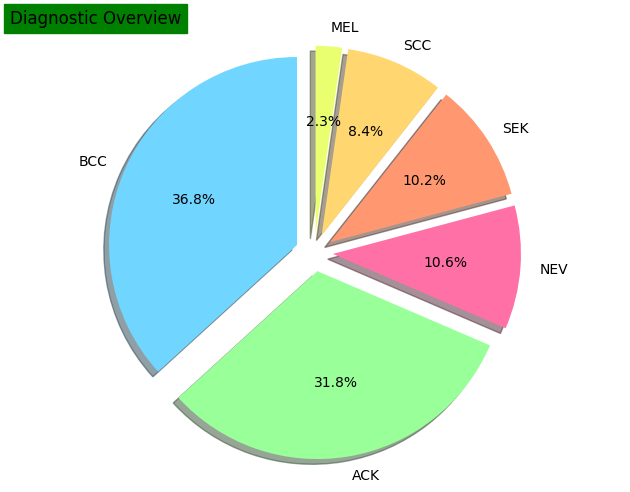

In [ ]:
pie_chart(metadata_skin_cancer,"diagnostic","Diagnostic Overview")

In [ ]:
metadata_skin_cancer['img_id'] = metadata_skin_cancer['img_id'].apply(lambda x:x.split('.')[0])
metadata_skin_cancer['img_file'] = metadata_skin_cancer['img_id'].apply(lambda x: x + '.png')
metadata_skin_cancer['target_file'] = metadata_skin_cancer['img_id'].apply(lambda x: x + '.tiff')

Note: Define Skin Cancer Classes: ('Skin Diseases', 'Skin Cancers')

In [ ]:
conditions = [
    (metadata_skin_cancer['diagnostic'] == 'NEV') | (metadata_skin_cancer['diagnostic'] == 'SEK') | (metadata_skin_cancer['diagnostic'] == 'ACK'),
    (metadata_skin_cancer['diagnostic'] == 'SCC') | (metadata_skin_cancer['diagnostic'] == 'BCC') | (metadata_skin_cancer['diagnostic'] == 'MEL')
    ]
choices = ['Skin Diseases', 'Skin Cancers']

metadata_skin_cancer['skin_type'] = np.select(conditions, choices, default='blank')

In [ ]:
conditions = [
    (metadata_skin_cancer['diagnostic'] == 'SCC'),
    (metadata_skin_cancer['diagnostic'] == 'BCC'),
    (metadata_skin_cancer['diagnostic'] == 'MEL'),
    (metadata_skin_cancer['diagnostic'] == 'NEV')|(metadata_skin_cancer['diagnostic'] == 'SEK')|(metadata_skin_cancer['diagnostic'] == 'ACK')
    ]
choices = ['SCC', 'BCC', 'MEL', 'Skin Diseases']

metadata_skin_cancer['diagnostic'] = np.select(conditions, choices, default='blank')

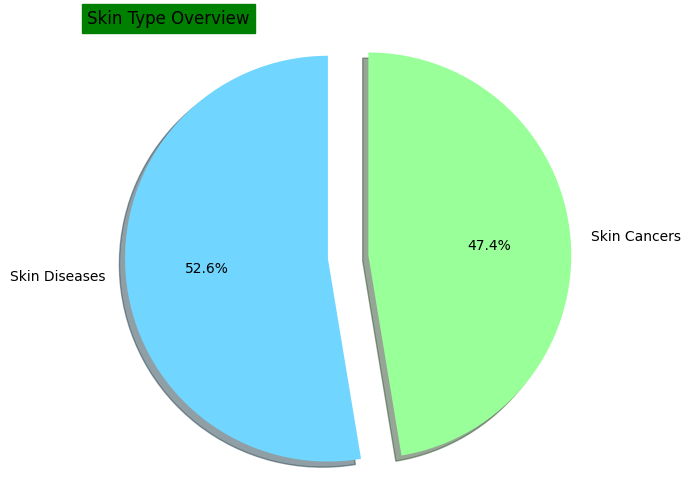

In [ ]:
pie_chart(metadata_skin_cancer,"skin_type", "Skin Type Overview")

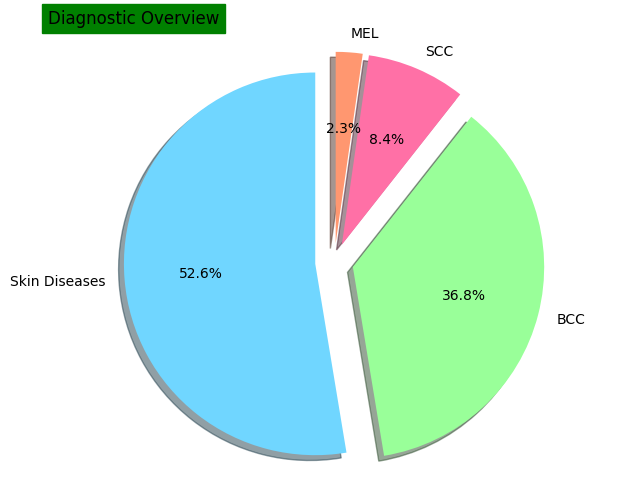

In [ ]:
pie_chart(metadata_skin_cancer,"diagnostic", "Diagnostic Overview")

In [ ]:
metadata_skin_cancer = metadata_skin_cancer[['img_id','img_file', 'target_file', 'diagnostic', 'skin_type']]

#### Random Sampler

In [ ]:
rus = RandomUnderSampler(random_state=42)
x_files = metadata_skin_cancer.drop('skin_type', axis=1)
y_files = metadata_skin_cancer['skin_type'].values
X_res, y_res = rus.fit_resample(x_files, y_files)

In [ ]:
master_data = pd.DataFrame(X_res, columns=x_files.columns)
master_data['skin_type'] = y_res

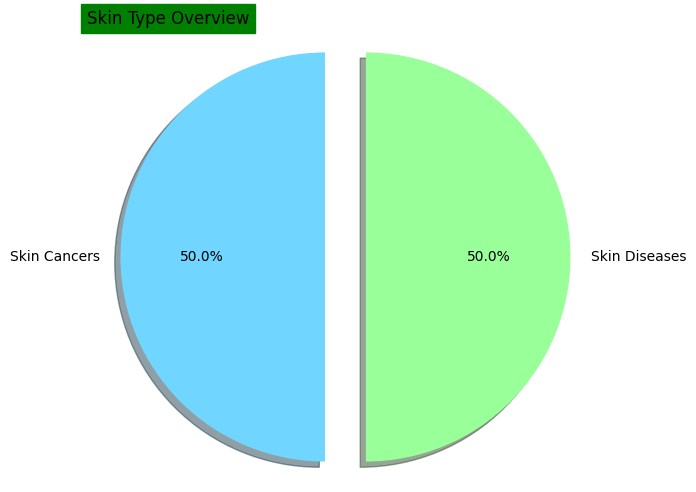

In [ ]:
pie_chart(master_data,"skin_type", "Skin Type Overview")

### Image Preprocessing

#### [Dullrazor algorithm](https://github.com/sunnyshah2894/DigitalHairRemoval)

In [ ]:
dullrazor_run = False

def dullrazor(img):
     """
     Following are the DHR tasks followed in this example code:

     -- Applying Morphological Black-Hat transformation
     -- Creating the mask for InPainting task
     -- Applying inpainting algorithm on the image
     """
     src = cv2.imread(img)
     # Convert the original image to grayscale
     grayScale = cv2.cvtColor( src, cv2.COLOR_RGB2GRAY )
     # Kernel for the morphological filtering
     kernel = cv2.getStructuringElement(1,(17,17))
     # Perform the blackHat filtering on the grayscale image to find the
     # hair countours
     blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
     # intensify the hair countours in preparation for the inpainting
     # algorithm
     _,thresh2 = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
     # inpaint the original image depending on the mask
     dst = cv2.inpaint(src,thresh2,1,cv2.INPAINT_TELEA)

     return dst

In [ ]:
def process_image(image, directory):
    img_path = os.path.join(directory, image)
    img = dullrazor(img_path)
    os.remove(img_path)
    cv2.imwrite(img_path, img)

In [ ]:
if not dullrazor_run:
    # Create a ThreadPoolExecutor
    images: list = metadata_skin_cancer['img_file'].tolist()
    with ThreadPoolExecutor() as executor:
        # Extract rows and apply processing
        # Use tqdm to show progress
        list(tqdm(executor.map(lambda image: process_image(image, images_directory), images), total=len(images)))
    dullrazor_run = True

100%|██████████| 2298/2298 [01:01<00:00, 37.18it/s]


#### Data Splitting

In [ ]:
traning_data, testing_data = train_test_split(master_data, test_size=0.025, stratify=master_data['skin_type'], random_state=42)

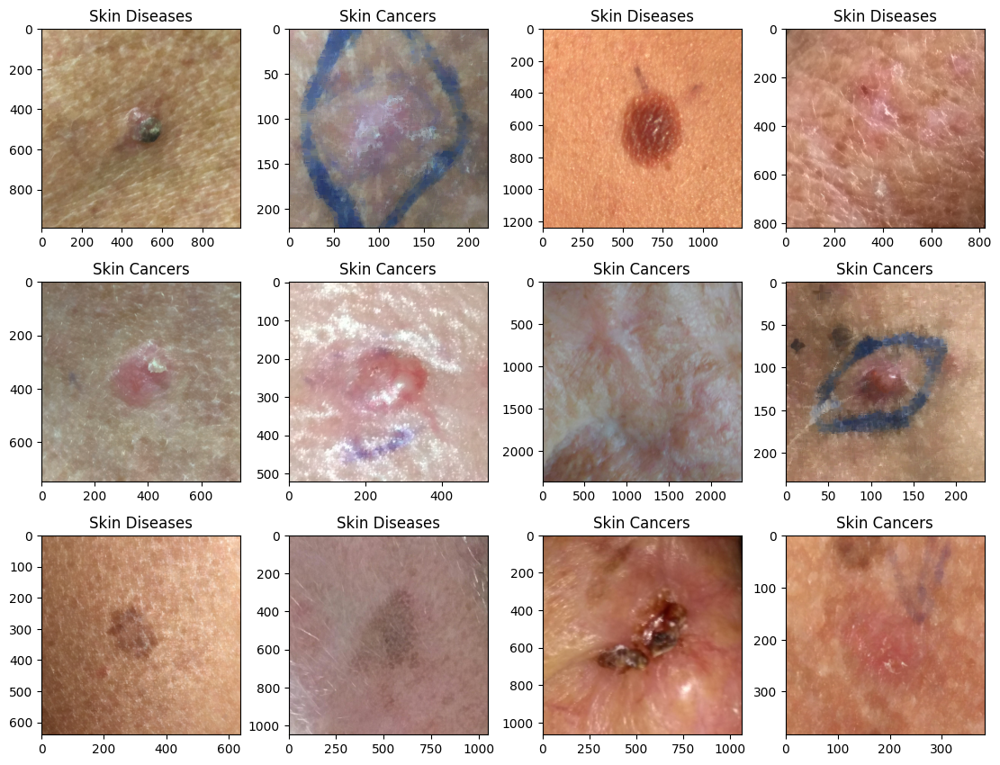

In [ ]:
# Display the images
plt.figure(figsize = (11,11),constrained_layout=True)
for index, row in traning_data.sample(n=12).reset_index(drop=True).iterrows():
    plt.subplot(4, 4, index+1)
    plt.imshow(load_img(f"{images_directory}{row['img_id']}.png"))
    plt.title(row['skin_type'])

#### Image Augmentation

In [ ]:
# Data generator apply different effect to the training images
train_datagen = ImageDataGenerator(rotation_range=20,       # Randomly rotate the images by up to 20 degrees
                                    rescale=1./255,         # Rescale the pixel values to the range [0, 1] by dividing by 255
                                    shear_range=0.1,        # Randomly shear the images by up to 10%
                                    zoom_range=0.1,         # Randomly zoom into the images by up to 10%
                                    horizontal_flip=True,   # Randomly flip the images horizontally
                                    vertical_flip=True,     # Randomly flip the images vertically
                                    width_shift_range=0.1,  # Randomly shift the images horizontally by up to 10% of the width
                                    height_shift_range=0.1, # Randomly shift the images vertically by up to 10% of the height
                                    fill_mode='nearest',    # Fill in missing pixels with the nearest filled value
                                    validation_split=0.2)   # Split the data into training and validation sets

# Generate data for training and validation
train_generator = train_datagen.flow_from_dataframe(traning_data,
                                                    images_directory,
                                                    x_col='img_file',
                                                    y_col='skin_type',
                                                    target_size=(224,224),
                                                    class_mode='categorical',
                                                    batch_size=16,
                                                    shuffle=True,
                                                    subset='training',
                                                    seed=42)
validation_generator = train_datagen.flow_from_dataframe(traning_data,
                                                            images_directory,
                                                            x_col='img_file',
                                                            y_col='skin_type',
                                                            target_size=(224,224),
                                                            class_mode='categorical',
                                                            batch_size=16,
                                                            shuffle=True,
                                                            subset='validation',
                                                            seed=42)

# Generate data for testing
test_generator = ImageDataGenerator()
test_generator = test_generator.flow_from_dataframe(testing_data,
                                                    images_directory,
                                                    x_col='img_file',
                                                    y_col='skin_type',
                                                    target_size=(224, 224),
                                                    class_mode='categorical',
                                                    shuffle=True)

# Uncomment this block if want to see a sample of data generator
example = testing_data.sample(n=1).reset_index(drop=True)
example_gen = train_datagen.flow_from_dataframe(example,
                                                images_directory,
                                                x_col = 'img_file',
                                                y_col = 'skin_type',
                                                target_size=(224,224),
                                                class_mode='categorical')

Found 1699 validated image filenames belonging to 2 classes.
Found 424 validated image filenames belonging to 2 classes.
Found 55 validated image filenames belonging to 2 classes.
Found 1 validated image filenames belonging to 1 classes.


In [ ]:
classes, class_indices = list(iter(train_generator.class_indices)), train_generator.class_indices
class_indices

{'Skin Cancers': 0, 'Skin Diseases': 1}

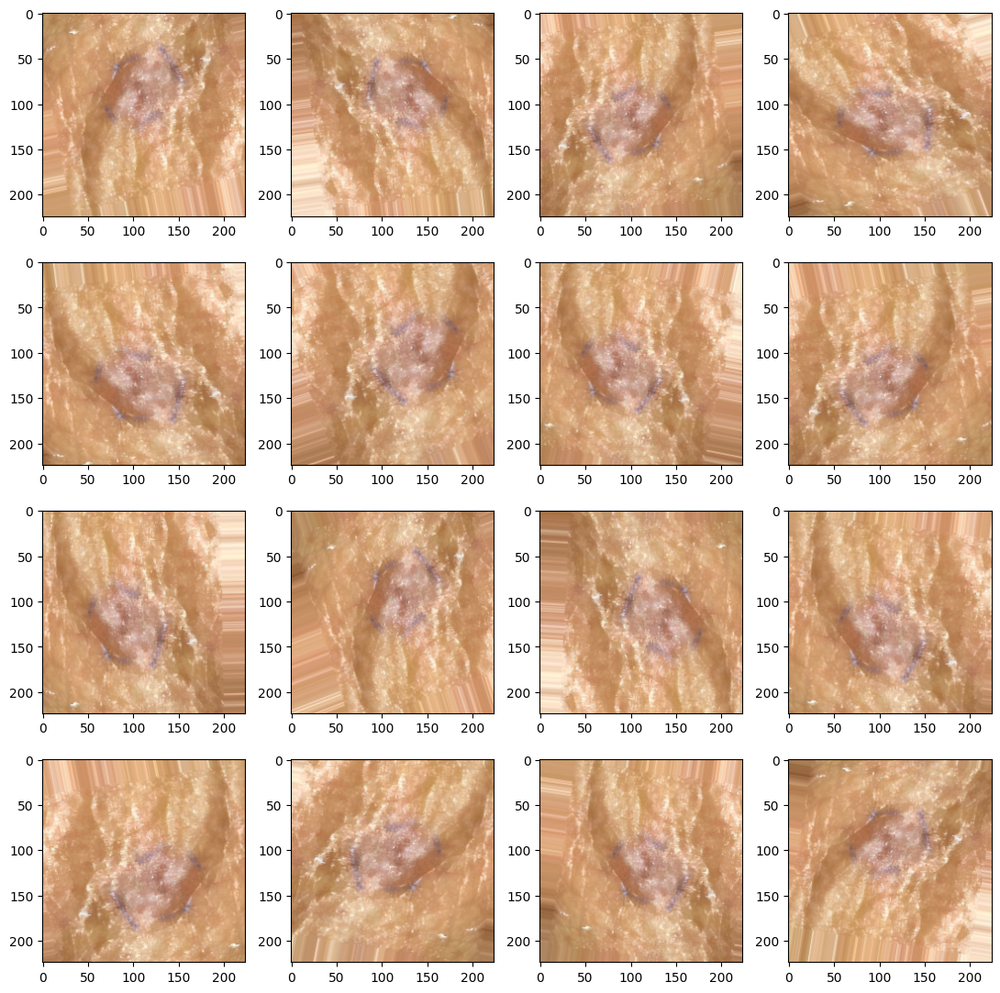

In [ ]:
plt.figure(figsize=(11,11))
for i in range(0, 16):
    plt.subplot(4,4,i+1)
    for X, Y in example_gen:
        image = X[0]
        plt.imshow(image)
        break
plt.tight_layout()
plt.show()

### CNN Transfer Learning & Fine-Tuning

In [ ]:
# Create a model, and removing the last layer that is classifying 1000 images. This will be replaced with images classes we have.
#Training with Imagenet weights
base_model = DenseNet121(input_shape=(224,224,3), weights= 'imagenet', include_top=False, pooling='max')
# freeze layer
base_model.trainable = False

layer = Flatten()(base_model.output)
layer = Dropout(0.2)(layer)
prediction = Dense(len(classes), activation='softmax')(layer)

#Creating model object
model = Model(inputs=base_model.input, outputs=prediction)

# Fine-tune from this layer onwards
len_layers = len(model.layers)
freeze = len_layers*0.20

# This sets the base that the layers are not trainable. If we'd want to train the layers with custom data, these two lines can be ommitted.
for layer in model.layers[int(freeze):]:
  layer.trainable = True

29084464/29084464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ",len(model.layers))

Number of layers in the base model:  431


In [ ]:
model.summary()
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics = ['accuracy'])

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d            │ (None, 230, 230, 3)    │              0 │ input_layer[0][0]      │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,408 │ zero_padding2d[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_1          │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1 (MaxPooling2D)      │ (None, 56, 56, 64)     │              0 │ zero_padding2d_1[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_bn         │ (None, 56, 56, 64)     │            256 │ pool1[0][0]            │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_0_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 128)    │          8,192 │ conv2_block1_0_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 128)    │            512 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 128)    │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 32)     │         36,864 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_concat       │ (None, 56, 56, 96)     │              0 │ pool1[0][0],           │
│ (Concatenate)             │                        │                │ conv2_block1_2_conv[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block2_0_bn    

 Total params: 7,039,554 (26.85 MB)

 Trainable params: 6,304,514 (24.05 MB)

 Non-trainable params: 735,040 (2.80 MB)

In [ ]:
# datetime for filename saving
filepath = model_checkpoint + f'weights-{{epoch:02d}}-{{val_accuracy:.2f}}.keras'

#define checkpoint
checkpoint = ModelCheckpoint(filepath,
                             monitor='val_accuracy',
                             save_best_only=True,
                             mode="max",
                             verbose=1)

#early stopping
earlystop = EarlyStopping(monitor='val_loss',
                          patience=3,
                          mode='auto',
                          verbose=1)

#reduce learning rate
reduce_lr = ReduceLROnPlateau(monitor = 'accuracy',
                              factor = 0.3,
                              patience = 2,
                              min_delta = 0.001,
                              mode='auto',
                              verbose=1)

### Monitoring the Model

In [ ]:
#Step 3: Initialize Tensorboard to monitor changes in Model Loss
%load_ext tensorboard
log_dir = "logs/cnn_fit/"
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
#Visualize on tensorboard (move this above)
%tensorboard --logdir logs/cnn_fit --port=6006

<IPython.core.display.Javascript object>

### Training

In [ ]:
history = model.fit(train_generator, epochs = 100, validation_data=validation_generator, callbacks=[checkpoint, reduce_lr, tensorboard_callback])

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


106/107 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.6112 - loss: 1.6656
Epoch 1: val_accuracy improved from -inf to 0.77358, saving model to ./checkpoint/weights-01-0.77.keras
107/107 ━━━━━━━━━━━━━━━━━━━━ 330s 2s/step - accuracy: 0.6119 - loss: 1.6624 - val_accuracy: 0.7736 - val_loss: 0.7182 - learning_rate: 1.0000e-04
Epoch 2/100
106/107 ━━━━━━━━━━━━━━━━━━━━ 0s 538ms/step - accuracy: 0.7401 - loss: 1.1100
Epoch 2: val_accuracy did not improve from 0.77358
107/107 ━━━━━━━━━━━━━━━━━━━━ 81s 719ms/step - accuracy: 0.7400 - loss: 1.1102 - val_accuracy: 0.7028 - val_loss: 1.2286 - learning_rate: 1.0000e-04
Epoch 3/100
106/107 ━━━━━━━━━━━━━━━━━━━━ 0s 535ms/step - accuracy: 0.7803 - loss: 0.8457
Epoch 3: val_accuracy did not improve from 0.77358
107/107 ━━━━━━━━━━━━━━━━━━━━ 81s 714ms/step - accuracy: 0.7801 - loss: 0.8468 - val_accuracy: 0.7500 - val_loss: 0.8621 - learning_rate: 1.0000e-04
Epoch 4/100
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 534ms/step - accuracy: 0.7938 - loss: 0.7806
Epoch 4: va

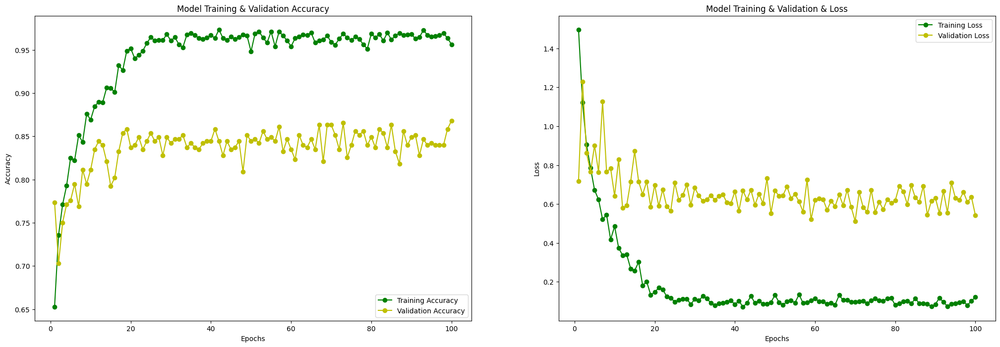

In [ ]:
fig , ax = plt.subplots(1,2)
fig.set_size_inches(25,8)

train_acc = history.history['accuracy']
train_loss = history.history['loss']
val_acc = history.history['val_accuracy']
val_loss = history.history['val_loss']

epochs = range(1, len(train_acc) + 1)

ax[0].plot(epochs , train_acc , 'g-o' , label = 'Training Accuracy')
ax[0].plot(epochs , val_acc , 'y-o' , label = 'Validation Accuracy')
ax[0].set_title('Model Training & Validation Accuracy')
ax[0].legend(loc = 'lower right')
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")

ax[1].plot(epochs , train_loss , 'g-o' , label = 'Training Loss')
ax[1].plot(epochs , val_loss , 'y-o' , label = 'Validation Loss')
ax[1].set_title('Model Training & Validation & Loss')
ax[1].legend()
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Loss")

plt.show()

### Evaluation and prediction

In [ ]:
val_loss, val_accuracy = model.evaluate(validation_generator)
print("Validate accuracy: {:.2f}%".format(val_accuracy * 100))
print("Validate loss: {:.4f}".format(val_loss))

27/27 ━━━━━━━━━━━━━━━━━━━━ 15s 572ms/step - accuracy: 0.8671 - loss: 0.7076
Validate accuracy: 83.73%
Validate loss: 0.6668


In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator)
print("Test accuracy: {:.2f}%".format(test_accuracy * 100))
print("Test loss: {:.4f}".format(test_loss))

2/2 ━━━━━━━━━━━━━━━━━━━━ 22s 10s/step - accuracy: 0.5390 - loss: 5.7155
Test accuracy: 52.73%
Test loss: 5.7848


In [ ]:
# define labels for testing
labels = test_generator.classes
labels =[list(class_indices.keys())[list(class_indices.values()).index(x)] for x in labels]
# make prediction
prediction_test = np.argmax(model.predict(test_generator, verbose=0), axis=1)
prediction_test =[list(class_indices.keys())[list(class_indices.values()).index(x)] for x in prediction_test]

In [ ]:
def plot_confusion_matrix(cm, classes,
                          normalize = False,
                          title = 'Confusion matrix',
                          cmap = "viridis"):

    plt.figure(figsize = (7,7))
    im_ = plt.imshow(cm, interpolation = 'nearest', cmap = cmap)
    plt.title(title)
    plt.colorbar()
    plt.grid(False)
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation = 90)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis = 1)[:, np.newaxis]

    thresh = (cm.max() + cm.min()) / 2.0
    cmap_min, cmap_max = im_.cmap(0), im_.cmap(1.0)
    cm = np.round(cm,2)
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 fontsize = 12,
                 horizontalalignment = "center",
                 color = cmap_max if cm[i, j] < thresh else cmap_min)

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

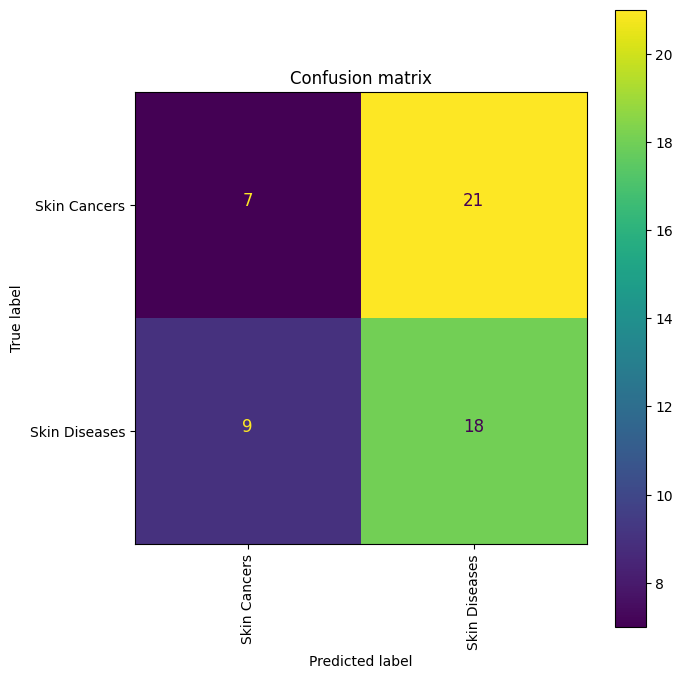

In [ ]:
#get confusion matrix
cm = confusion_matrix(labels, prediction_test)

#plot
plot_confusion_matrix(cm, classes, normalize=False)

In [ ]:
#get classification report
print(classification_report(labels, prediction_test, zero_division=1))

               precision    recall  f1-score   support

 Skin Cancers       0.44      0.25      0.32        28
Skin Diseases       0.46      0.67      0.55        27

     accuracy                           0.45        55
    macro avg       0.45      0.46      0.43        55
 weighted avg       0.45      0.45      0.43        55



In [ ]:
prediction, original, image, expand_dims = [], [], [], []

for index, row in tqdm(testing_data.iterrows()):
  #open the image
  img= load_img(images_directory+row['img_file'], target_size=(224,224))
  #append to image list
  image.append(img)
  #expand dimension
  img = np.expand_dims(img, axis=0)
  expand_dims.append(img)
  #predict & get the index corresponding to the highest value in the prediction
  predict =  np.argmax(model.predict(img, verbose=0))
  #append the predicted class to the list
  prediction.append(list(class_indices.keys())[list(class_indices.values()).index(predict)])
  #append original class to the list
  original.append(row['skin_type'])

55it [00:16,  3.31it/s]


### Visualize GradCAM

In [ ]:
#used the VizGradCam code from gkeechin.py VizGradCam is the fastest way to visualize GradCAM in Keras models.
#https://github.com/gkeechin/vizgradcam/blob/main/gradcam.py

import cv2
import numpy as np
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt
import tensorflow as tf

def VizGradCAM(model, image, interpolant=0.7, plot_results=True, plot_return=False):
    """VizGradCAM - Displays GradCAM based on Keras / TensorFlow models
    using the gradients from the last convolutional layer.
    Parameters:
    model (keras.Model): Compiled model with weights loaded
    image (numpy.array): Image to perform inference on
    interpolant (float): Interpolation factor for combining heatmap and image
    plot_results (bool): Whether to plot the results
    plot_return (bool): Whether to return the heatmap and superimposed image
    Returns:
    numpy.array: Heatmap if plot_results is False and plot_return is True
    """
    assert 0 < interpolant < 1, "Heatmap Interpolation Must Be Between 0 - 1"

    # Find the last convolutional layer in the model
    last_conv_layer = next(x for x in model.layers[::-1] if isinstance(x, tf.keras.layers.Conv2D))
    target_layer = model.get_layer(last_conv_layer.name)

    img = np.expand_dims(image, axis=0)
    prediction = model.predict(img, verbose=0)

    # Obtain Prediction Index
    prediction_idx = np.argmax(prediction)

    # Compute Gradient of Top Predicted Class
    with tf.GradientTape() as tape:
        gradient_model = Model([model.inputs], [target_layer.output, model.output])
        conv2d_out, prediction = gradient_model(img)
        loss = prediction[:, prediction_idx]

    # Gradient computation
    gradients = tape.gradient(loss, conv2d_out)
    output = conv2d_out[0]
    weights = tf.reduce_mean(gradients[0], axis=(0, 1))

    # Create activation map
    activation_map = np.zeros(output.shape[0:2], dtype=np.float32)
    for idx, weight in enumerate(weights):
        activation_map += weight * output[:, :, idx]

    # Resize to size of image
    activation_map = cv2.resize(activation_map.numpy(), (image.shape[1], image.shape[0]))

    # Normalize the activation map
    activation_map = np.maximum(activation_map, 0)
    if activation_map.max() != activation_map.min():
        activation_map = (activation_map - activation_map.min()) / (activation_map.max() - activation_map.min())
    activation_map = np.uint8(255 * activation_map)

    # Convert to heatmap
    heatmap = cv2.applyColorMap(activation_map, cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)

    # Prepare original image
    original_img = np.uint8((image - image.min()) / (image.max() - image.min()) * 255)

    # Superimpose heatmap on original image
    superimposed_img = np.uint8(original_img * interpolant + heatmap * (1 - interpolant))

    # Plot or return results
    if plot_results:
        plt.imshow(superimposed_img)
        plt.axis('off')
        plt.show()
    if plot_return:
        return heatmap, superimposed_img

    return heatmap

In [ ]:
def Classify(image_array,show=True):
    img = np.expand_dims(image_array, axis=0)
    img = np.vstack([img])
    pred = model.predict(img, verbose=0)
    score = tf.nn.softmax(pred[0])
    if show == True:
        print(
        "This image most likely belongs to {} with a {:.2f} percent confidence."
        .format(classes[np.argmax(score)], 100 * np.max(score)))

    pred_class = classes[np.argmax(pred)]

    return pred_class

Dimensions :  <PIL.Image.Image image mode=RGB size=224x224 at 0x7A3901B42500>


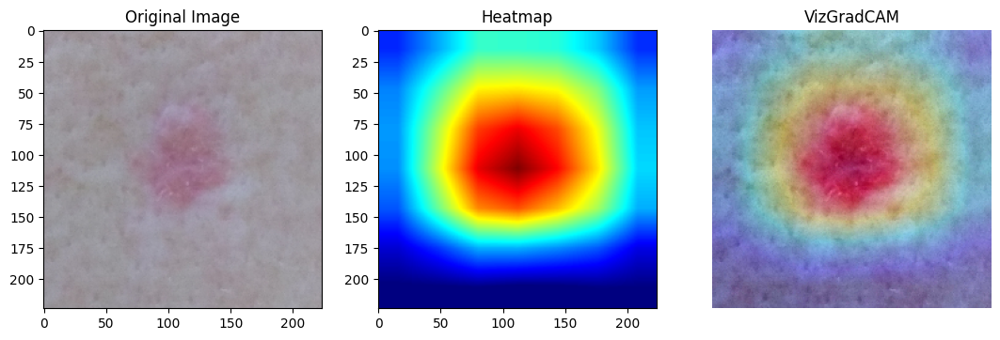

In [ ]:
test_img = load_img("./images/PAT_666_1271_645.png", target_size=(224, 224))
print('Dimensions : ',test_img)

fig , ax = plt.subplots(1,3)
fig.set_size_inches(13,13)

ax[0].set_title('Original Image')
ax[0].imshow(test_img)
ax[1].set_title('Heatmap')
ax[1].imshow(VizGradCAM(model, img_to_array(test_img), plot_results=False))
ax[2].set_title('VizGradCAM')
ax[2] = VizGradCAM(model, img_to_array(test_img), plot_results=True)

0it [00:00, ?it/s]

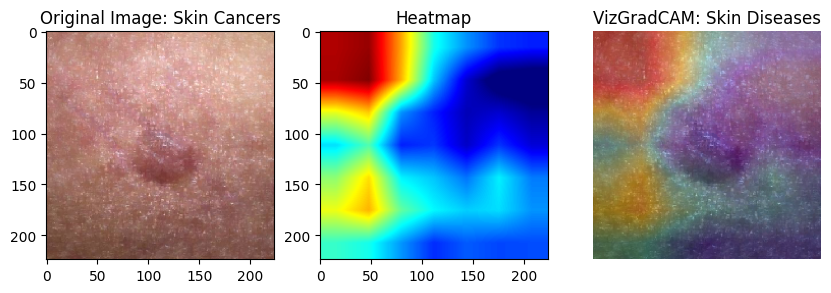

1it [00:02,  2.87s/it]

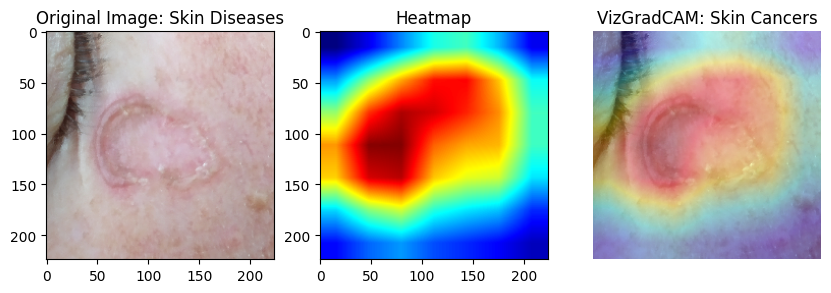

2it [00:05,  2.48s/it]

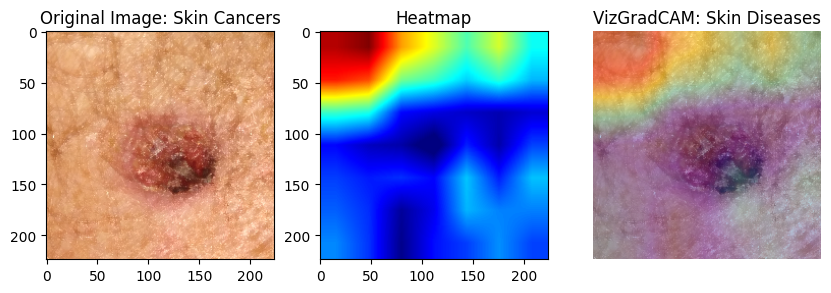

3it [00:07,  2.42s/it]


In [ ]:
files_path_test = testing_data.sample(n=3).reset_index(drop=True)

#visualize
for index, row in tqdm(files_path_test.iterrows()):
    img = load_img(images_directory+row['img_file'], target_size=(224,224))
    fig , ax = plt.subplots(1,3)
    fig.set_size_inches(10,10)
    ax[0].set_title('Original Image: '+row['skin_type'])
    ax[0].imshow(img)
    ax[1].set_title('Heatmap')
    ax[1].imshow(VizGradCAM(model, img_to_array(img), plot_results=False))
    ax[2].set_title('VizGradCAM: '+ Classify(img,show=False))
    ax[2] = VizGradCAM(model, img_to_array(img), plot_results=True)

In [ ]:
files_path_test = testing_data.sample(n=8).reset_index(drop=True)

100%|██████████| 8/8 [00:07<00:00,  1.06it/s]


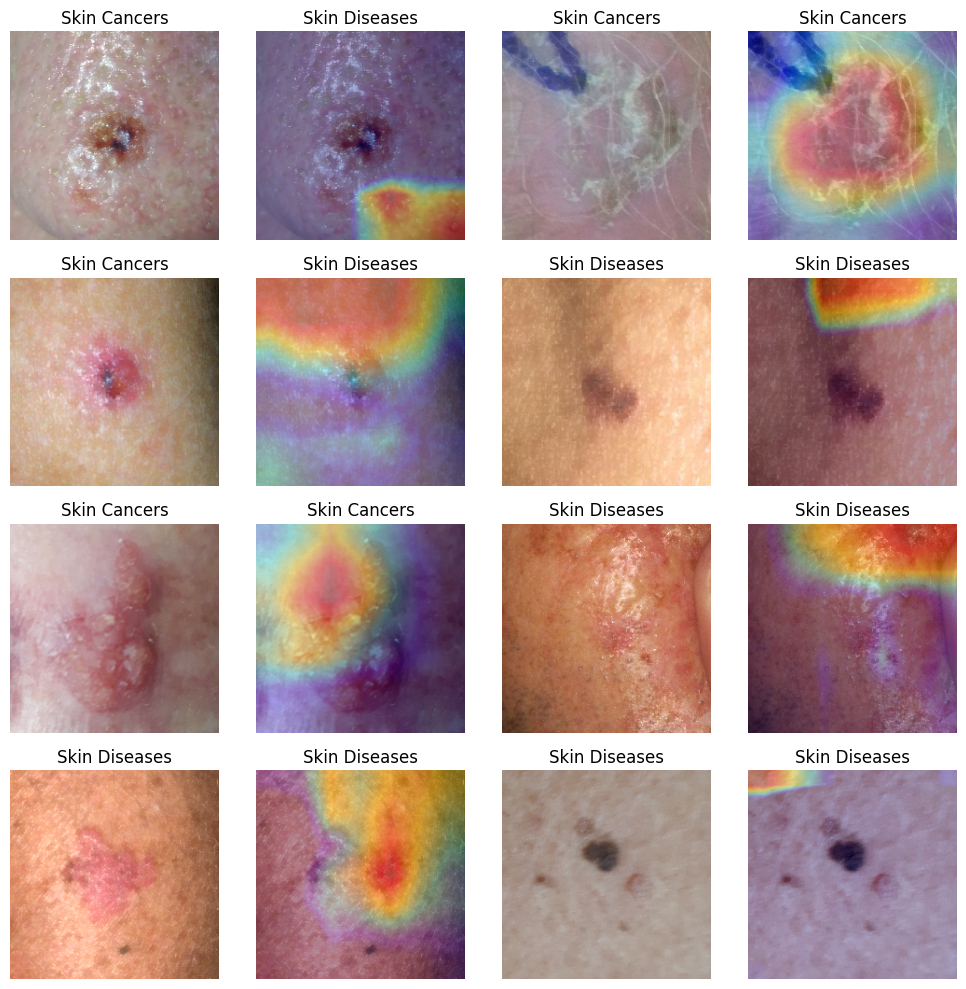

In [ ]:
# Assuming files_path_test and images_directory are defined
fig, axs = plt.subplots(4, 4, figsize=(10, 10))
axs = axs.flatten()  # Flatten the 2D array of axes to simplify indexing

i = 0
for index, row in tqdm(files_path_test.iterrows(), total=files_path_test.shape[0]):
    # Load the image
    img = load_img(images_directory + row['img_file'], target_size=(224, 224))
    img_array = img_to_array(img)

    # Original image with title
    axs[i].set_title(row['skin_type'])
    axs[i].imshow(img)
    axs[i].axis('off')
    i += 1

    # Grad-CAM visualization with title
    classification = Classify(img, show=False)
    heatmap, superimposed_img = VizGradCAM(model, img_array, plot_results=False, plot_return=True)

    axs[i].set_title(classification)
    axs[i].imshow(superimposed_img)
    axs[i].axis('off')
    i += 1

plt.tight_layout()
plt.show()


### Image Segmentation

In [ ]:
# number of classes in segmentation dataset
unet_classes = master_data['diagnostic'].unique()

In [ ]:
count_values_in_column(master_data, 'diagnostic')

,Total,Percentage
diagnostic,,
Skin Diseases,1089,50.00
BCC,845,38.80
SCC,192,8.82
MEL,52,2.39


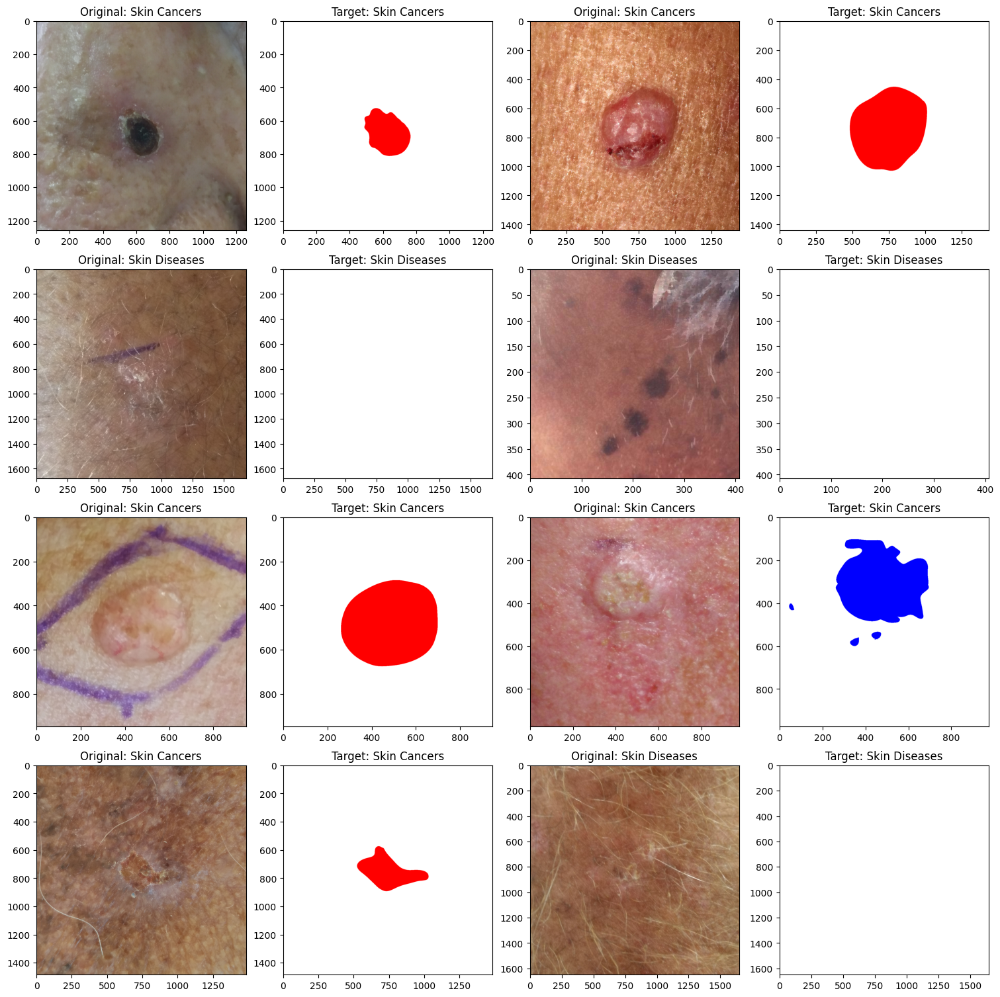

In [ ]:
view_taget = master_data.sample(n=8, random_state=42).reset_index(drop=True)

# Display Input Images and Target Labels
plt.figure(figsize = (15,15),constrained_layout=True)
i = 1
for index, row in view_taget.iterrows():
    plt.subplot(4, 4, i)
    plt.imshow(load_img(images_directory+row['img_file']))
    plt.title("Original: "+row['skin_type'])
    i += 1
    plt.subplot(4, 4, i)
    plt.imshow(load_img(labeling_directory+row['target_file']))
    plt.title("Target: "+row['skin_type'])
    i += 1

### Image Encoding

In [ ]:
#presents each class name, corresponding hex colour code, and converted RBG values.
class MaskColorMap(Enum):
    SCC = (0, 128 ,0)
    BCC = (255, 0, 0)
    MEL = (0, 0, 255)
    Diseases = (255, 255, 255)

In [ ]:
def load_images_and_patchify(img_path, patch_size):
    """
    :param patch_size: image patchify square size
    :param directory_path: path to root directory containing training and test images
    :return: list of images from directory
    """
    # initialize empty list for images
    instances = []
    # Reads image
    image = img_to_array(load_img(img_path,target_size=(patch_size,patch_size)),dtype=np.uint8)

    # Extract patches from each image, step=patch_size means no overlap
    patch_img = patchify(image, (patch_size, patch_size, 3), step=patch_size)

    # iterate over vertical patch axis
    for j in range(patch_img.shape[0]):
        # iterate over horizontal patch axis
        for k in range(patch_img.shape[1]):
            # patches are located like a grid. use (j, k) indices to extract single patched image
            single_patch_img = patch_img[j, k]
            # Drop extra extra dimension from patchify
            instances.append(np.squeeze(single_patch_img))

    return instances

In [ ]:
def get_training_data(Dataframe, directory_path, directory_target, patch_size):
    # initialise lists
    image_dataset, mask_dataset = [], []

    # walk through root directory
    for _, row in tqdm(Dataframe.iterrows()):
        image_dataset.extend(load_images_and_patchify(directory_path+row['img_file'], patch_size))
        mask_dataset.extend(load_images_and_patchify(directory_target+row['target_file'], patch_size))

    # return input images and masks
    return np.array(image_dataset), np.array(mask_dataset)

In [ ]:
def display_images(instances, rows=2, titles=None):
    """
    :param instances:  list of images
    :param rows: number of rows in subplot
    :param titles: subplot titles
    :return:
    """
    n = len(instances)
    cols = n // rows if (n / rows) % rows == 0 else (n // rows) + 1
    # Display Input Images and Target Labels
    plt.figure(figsize = (10,10),constrained_layout=True)
    for j, image in enumerate(instances):
        plt.subplot(4, 4, j + 1)
        plt.title('') if titles is None else plt.title(titles[j])
        plt.imshow(image)

In [ ]:
def one_hot_encode_masks(masks, num_classes):
    """
    :param masks: Y_train patched mask dataset
    :param num_classes: number of classes
    :return:
    """
    # initialise list for integer encoded masks
    integer_encoded_labels = []

    # iterate over each mask
    for mask in tqdm(masks):

        # get image shape
        _img_height, _img_width, _img_channels = mask.shape

        # create new mask of zeros
        encoded_image = np.zeros((_img_height, _img_width, 1)).astype(int)

        for j, cls in enumerate(MaskColorMap):
            encoded_image[np.all(mask == cls.value, axis=-1)] = j

        # append encoded image
        integer_encoded_labels.append(encoded_image)

    # return one-hot encoded labels
    return to_categorical(integer_encoded_labels, num_classes=num_classes)

#### Random Sampler

In [ ]:
unet_x_files = metadata_skin_cancer.drop('diagnostic', axis=1)
unet_y_files = metadata_skin_cancer['diagnostic'].values

print('Original dataset shape %s' % Counter(unet_y_files))

# Determine the desired proportion (e.g., 0.75)
desired_proportion = .4

# Calculate the number of samples for each class
class_counts = Counter(unet_y_files)
majority_class_count = max(class_counts.values())

# Calculate the target number of samples for each class, ensuring it doesn't exceed the original counts
sampling_strategy = {cls: min(int(majority_class_count * desired_proportion), count)
                     for cls, count in class_counts.items()}

print('Sampling strategy: %s' % sampling_strategy)

# Initialize the RandomUnderSampler with the desired sampling strategy
rus = RandomUnderSampler(sampling_strategy=sampling_strategy, random_state=42)

# Resample the dataset
unet_X_res, unet_y_res = rus.fit_resample(unet_x_files, unet_y_files)

print('Resampled dataset shape %s' % Counter(unet_y_res))

Original dataset shape Counter({'Skin Diseases': 1209, 'BCC': 845, 'SCC': 192, 'MEL': 52})
Sampling strategy: {'Skin Diseases': 483, 'BCC': 483, 'SCC': 192, 'MEL': 52}
Resampled dataset shape Counter({'BCC': 483, 'Skin Diseases': 483, 'SCC': 192, 'MEL': 52})


In [ ]:
unet_master_data = pd.DataFrame(unet_X_res, columns=unet_x_files.columns)
unet_master_data['diagnostic'] = unet_y_res

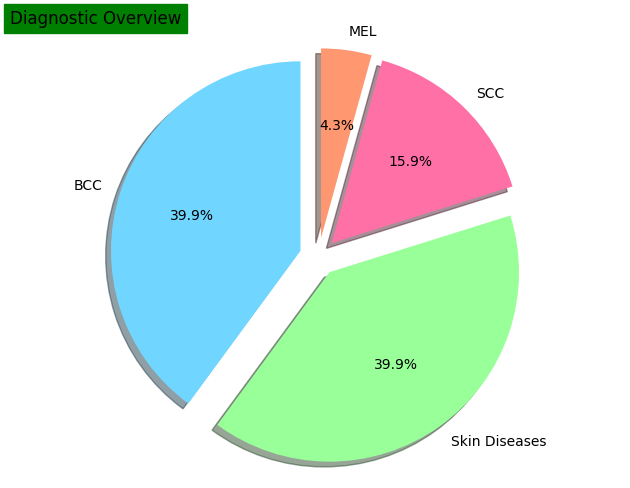

In [ ]:
pie_chart(unet_master_data,"diagnostic", "Diagnostic Overview")

### Read image set & mask set

In [ ]:
# create (X, Y) training data
images_set, masks_set = get_training_data(unet_master_data, images_directory, labeling_directory, 224)
# extract X_train shape parameters
m, img_height, img_width, img_channels = images_set.shape

1210it [00:42, 28.50it/s]


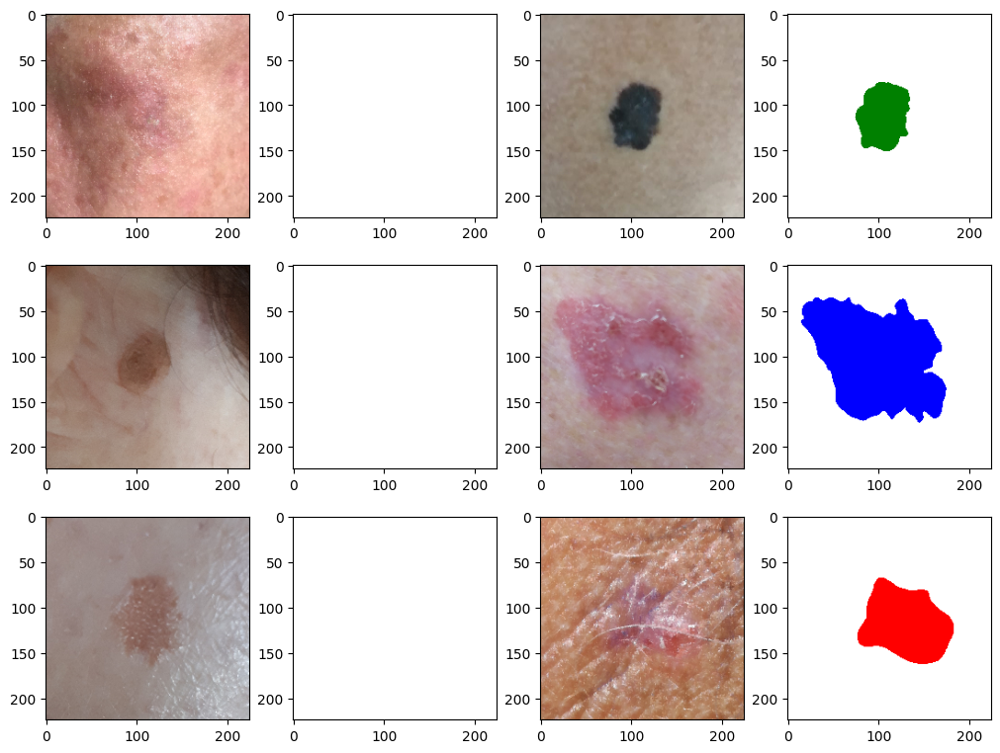

In [ ]:
# display images from both training and test sets
display_count = 6
random_index = [np.random.randint(0, m) for _ in range(display_count)]
unet_sample_images = [masks_set for pair in zip(list(images_set[random_index]), list(masks_set[random_index])) for masks_set in pair]
display_images(unet_sample_images, rows=3)

In [ ]:
# convert RGB values to ineger encoded labels for categorial_crossentropy
Y_unet = one_hot_encode_masks(masks_set, num_classes= len(unet_classes))

100%|██████████| 1210/1210 [00:07<00:00, 151.80it/s]


#### Data Splitting

In [ ]:
# split dataset into training and test groups
X_train_unet, X_valid_unet, Y_train_unet, Y_valid_unet = train_test_split(images_set, Y_unet, test_size=0.2, random_state=42)

In [ ]:
print('Amount of X_train data:', X_train_unet.shape[0])
print('Amount of test data:', X_valid_unet.shape[0])

Amount of X_train data: 968
Amount of test data: 242


#### U-Net Architecture

In [ ]:
# define U-Net model architecture
def build_unet(img_shape, n_classes):
    # input layer shape is equal to patch image size
    inputs = Input(shape=img_shape)

    # rescale images from (0, 255) to (0, 1)
    rescale = Rescaling(scale=1. / 255, input_shape=(img_height, img_width, img_channels))(inputs)
    previous_block_activation = rescale  # Set aside residual

    contraction = {}
    # # Contraction path: Blocks 1 through 5 are identical apart from the feature depth
    for f in [16, 32, 64, 128]:
        x = Conv2D(f, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(previous_block_activation)
        x = Dropout(0.1)(x)
        x = Conv2D(f, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(x)
        contraction[f'conv{f}'] = x
        x = MaxPooling2D((2, 2))(x)
        previous_block_activation = x

    c5 = Conv2D(160, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(previous_block_activation)
    c5 = Dropout(0.2)(c5)
    c5 = Conv2D(160, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)
    previous_block_activation = c5

    # Expansive path: Second half of the network: upsampling inputs
    for f in reversed([16, 32, 64, 128]):
        x = Conv2DTranspose(f, (2, 2), strides=(2, 2), padding='same')(previous_block_activation)
        x = concatenate([x, contraction[f'conv{f}']])
        x = Conv2D(f, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(x)
        x = Dropout(0.2)(x)
        x = Conv2D(f, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(x)
        previous_block_activation = x

    outputs = Conv2D(filters=n_classes, kernel_size=(1, 1), activation="softmax")(previous_block_activation)

    return Model(inputs=inputs, outputs=outputs)

In [ ]:
# jaccard similarity: the size of the intersection divided by the size of the union of two sets
def jaccard_index(y_true, y_pred):
    y_true_f = backend.flatten(y_true)
    y_pred_f = backend.flatten(y_pred)
    intersection = backend.sum(y_true_f * y_pred_f)
    return (intersection + 1.0) / (backend.sum(y_true_f) + backend.sum(y_pred_f) - intersection + 1.0)

In [ ]:
# build model
u_model = build_unet(img_shape=(img_height, img_width, img_channels), n_classes=len(unet_classes))
u_model.summary()
u_model.compile(optimizer=Adam(learning_rate=0.0001), loss="categorical_crossentropy", metrics=["accuracy", jaccard_index])

/usr/local/lib/python3.10/dist-packages/keras/src/layers/preprocessing/tf_data_layer.py:19: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "functional_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_10            │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ rescaling_9 (Rescaling)   │ (None, 224, 224, 3)    │              0 │ input_layer_10[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_171 (Conv2D)       │ (None, 224, 224, 16)   │            448 │ rescaling_9[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_82 (Dropout)      │ (None, 224, 224, 16)   │              0 │ conv2d_171[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_172 (Conv2D)       │ (None, 224, 224, 16)   │          2,320 │ dropout_82[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_36          │ (None, 112, 112, 16)   │              0 │ conv2d_172[0][0]       │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_173 (Conv2D)       │ (None, 112, 112, 32)   │          4,640 │ max_pooling2d_36[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_83 (Dropout)      │ (None, 112, 112, 32)   │              0 │ conv2d_173[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_174 (Conv2D)       │ (None, 112, 112, 32)   │          9,248 │ dropout_83[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_37          │ (None, 56, 56, 32)     │              0 │ conv2d_174[0][0]       │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_175 (Conv2D)       │ (None, 56, 56, 64)     │         18,496 │ max_pooling2d_37[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_84 (Dropout)      │ (None, 56, 56, 64)     │              0 │ conv2d_175[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_176 (Conv2D)       │ (None, 56, 56, 64)     │         36,928 │ dropout_84[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_38          │ (None, 28, 28, 64)     │              0 │ conv2d_176[0][0]       │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_177 (Conv2D)       │ (None, 28, 28, 128)    │         73,856 │ max_pooling2d_38[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_85 (Dropout)      │ (None, 28, 28, 128)    │              0 │ conv2d_177[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_178 (Conv2D)       │ (None, 28, 28, 128)    │        147,584 │ dropout_85[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_39     

 Total params: 1,421,796 (5.42 MB)

 Trainable params: 1,421,796 (5.42 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
log_dir_unet = "logs/unet_fit/"
tensorboard_callback_unet = tf.keras.callbacks.TensorBoard(log_dir=log_dir_unet, histogram_freq=1)

In [ ]:
%tensorboard --logdir logs/unet_fit --port=6007

<IPython.core.display.Javascript object>

In [ ]:
# datetime for filename saving
unet_filepath = model_checkpoint + f'unet-weights-{{epoch:02d}}-{{val_jaccard_index:.3f}}.keras'

#define checkpoint
u_checkpoint = ModelCheckpoint(unet_filepath,
                             monitor='val_jaccard_index',
                             save_best_only=True,
                             mode="max",
                             verbose=1)

#early stopping
u_earlystop = EarlyStopping(monitor='val_loss',
                          patience=3,
                          mode='auto',
                          verbose=1)

#reduce learning rate
u_reduce_lr = ReduceLROnPlateau(monitor = 'jaccard_index',
                              factor = 0.3,
                              patience = 2,
                              min_delta = 0.001,
                              mode='auto',
                              verbose=1)

In [ ]:
u_history = u_model.fit(X_train_unet, Y_train_unet, epochs=100, batch_size=8, validation_data=(X_valid_unet, Y_valid_unet), callbacks=[u_checkpoint, u_reduce_lr, tensorboard_callback_unet])

Epoch 1/100
120/121 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.6959 - jaccard_index: 0.4106 - loss: 0.8447
Epoch 1: val_jaccard_index improved from -inf to 0.64129, saving model to ./checkpoint/unet-weights-01-0.641.keras
121/121 ━━━━━━━━━━━━━━━━━━━━ 20s 51ms/step - accuracy: 0.6982 - jaccard_index: 0.4133 - loss: 0.8406 - val_accuracy: 0.9243 - val_jaccard_index: 0.6413 - val_loss: 0.3636 - learning_rate: 1.0000e-04
Epoch 2/100
120/121 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - accuracy: 0.9172 - jaccard_index: 0.7239 - loss: 0.3612
Epoch 2: val_jaccard_index improved from 0.64129 to 0.64592, saving model to ./checkpoint/unet-weights-02-0.646.keras
121/121 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - accuracy: 0.9172 - jaccard_index: 0.7239 - loss: 0.3611 - val_accuracy: 0.9243 - val_jaccard_index: 0.6459 - val_loss: 0.3385 - learning_rate: 1.0000e-04
Epoch 3/100
121/121 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.9141 - jaccard_index: 0.7353 - loss: 0.3320
Epoch 3: val_jaccard_index did not

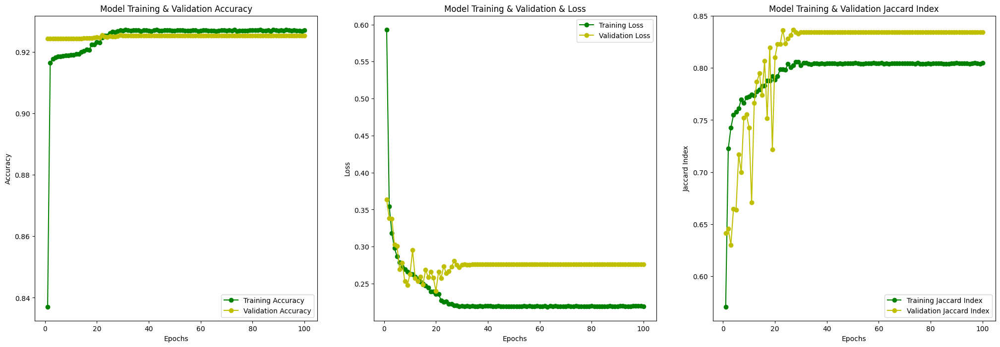

In [ ]:
fig , ax = plt.subplots(1,3)
fig.set_size_inches(25,8)

train_acc = u_history.history['accuracy']
train_loss = u_history.history['loss']
val_acc = u_history.history['val_accuracy']
val_loss = u_history.history['val_loss']

epochs = range(1, len(train_acc) + 1)

ax[0].plot(epochs , train_acc , 'g-o' , label = 'Training Accuracy')
ax[0].plot(epochs , val_acc , 'y-o' , label = 'Validation Accuracy')
ax[0].set_title('Model Training & Validation Accuracy')
ax[0].legend(loc = 'lower right')
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")

ax[1].plot(epochs , train_loss , 'g-o' , label = 'Training Loss')
ax[1].plot(epochs , val_loss , 'y-o' , label = 'Validation Loss')
ax[1].set_title('Model Training & Validation & Loss')
ax[1].legend()
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Loss")

ax[2].plot(epochs , u_history.history['jaccard_index'] , 'g-o' , label = 'Training Jaccard Index')
ax[2].plot(epochs , u_history.history['val_jaccard_index'] , 'y-o' , label = 'Validation Jaccard Index')
ax[2].set_title('Model Training & Validation Jaccard Index')
ax[2].legend(loc = 'lower right')
ax[2].set_xlabel("Epochs")
ax[2].set_ylabel("Jaccard Index")

plt.show()

In [ ]:
def rgb_encode_mask(mask):
    # initialize rgb image with equal spatial resolution
    rgb_encode_image = np.zeros((mask.shape[0], mask.shape[1], 3))

    # iterate over MaskColorMap
    for j, cls in enumerate(MaskColorMap):
        # convert single integer channel to RGB channels
        rgb_encode_image[(mask == j)] = np.array(cls.value) / 255.
    return rgb_encode_image

In [ ]:
u_val_loss, u_val_accuracy, u_val_jaccard = u_model.evaluate(X_valid_unet, Y_valid_unet)
print("Validate accuracy: {:.2f}%".format(u_val_accuracy * 100))
print("Validate loss: {:.4f}".format(u_val_loss))
print("Validate Jaccard Index: {:.2f}%".format(u_val_jaccard))

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 141ms/step - accuracy: 0.9240 - jaccard_index: 0.8307 - loss: 0.2761
Validate accuracy: 92.52%
Validate loss: 0.2758
Validate Jaccard Index: 0.83%


In [ ]:
test_images_set, test_masks_set = get_training_data(testing_data, images_directory, labeling_directory, 224)
test_Y_unet = one_hot_encode_masks(test_masks_set, num_classes=len(unet_classes))
u_test_loss, u_test_accuracy, u_test_jaccard = u_model.evaluate(test_images_set, test_Y_unet)
print("Test accuracy: {:.2f}%".format(u_test_accuracy * 100))
print("Test loss: {:.4f}".format(u_test_loss))
print("Test Jaccard Index: {:.4f}".format(u_test_jaccard))

55it [00:02, 23.13it/s]
100%|██████████| 55/55 [00:00<00:00, 156.84it/s]


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 766ms/step - accuracy: 0.9346 - jaccard_index: 0.8356 - loss: 0.2214
Test accuracy: 93.75%
Test loss: 0.2132
Test Jaccard Index: 0.8447


In [ ]:
unet_prediction_test = np.argmax(u_model.predict(test_images_set, verbose=0), axis=3)
unet_cm = confusion_matrix(np.argmax(test_Y_unet, axis=3).flatten(), unet_prediction_test.flatten())

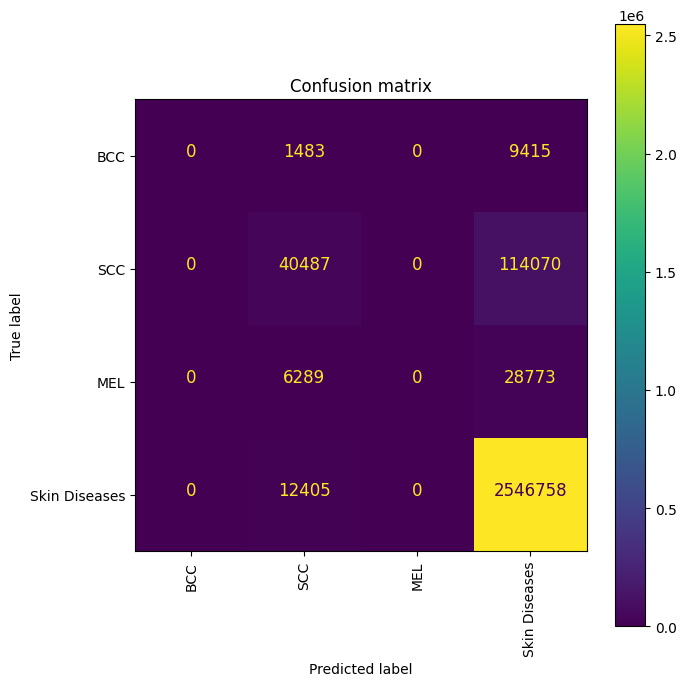

In [ ]:
plot_confusion_matrix(unet_cm, unet_classes, normalize=False)

20it [00:03,  7.46it/s]<ipython-input-233-cf017a4dca50>:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (10,10),constrained_layout=True)
30it [00:04,  6.69it/s]


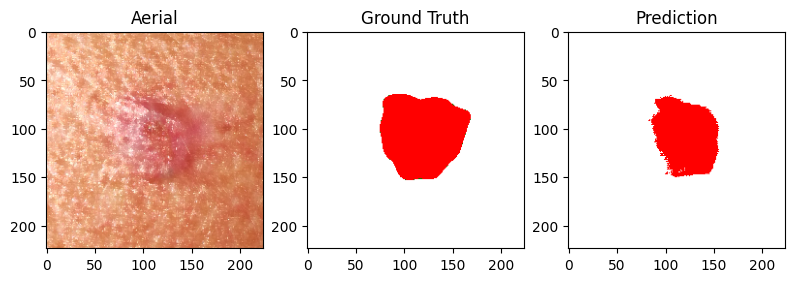

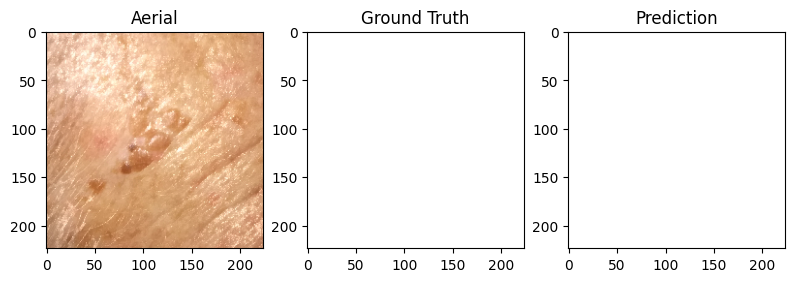

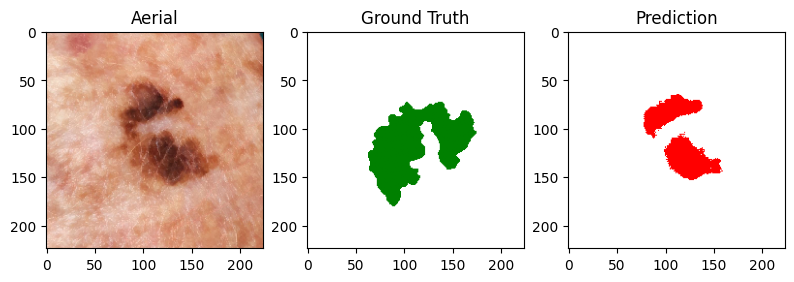

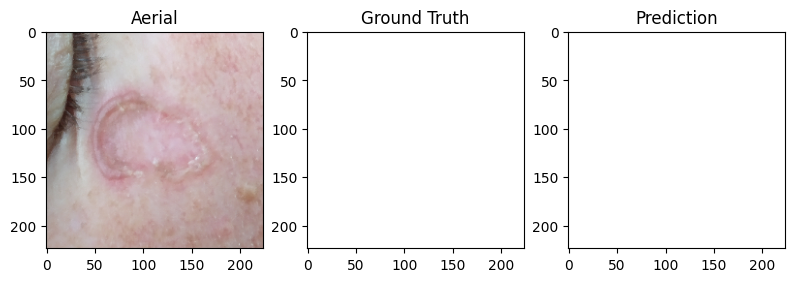

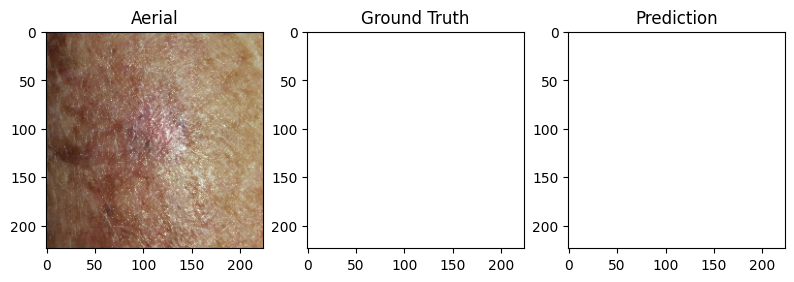

...

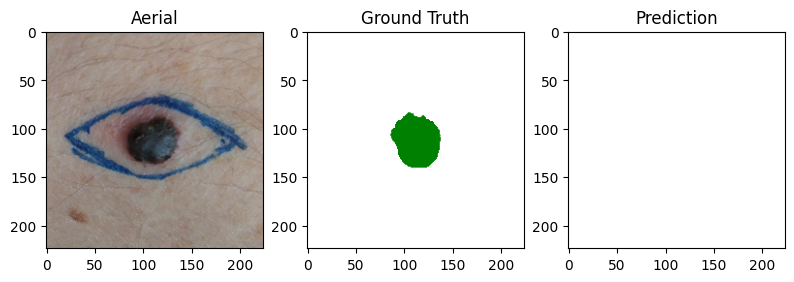

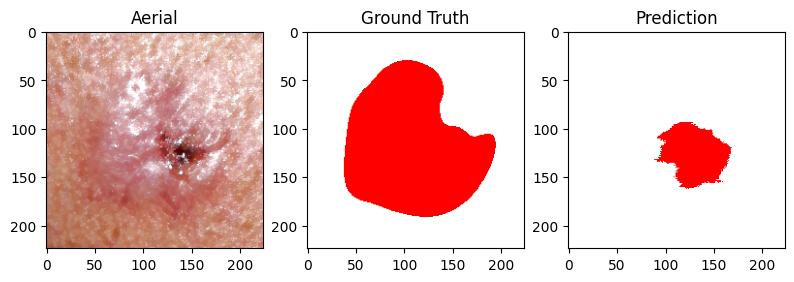

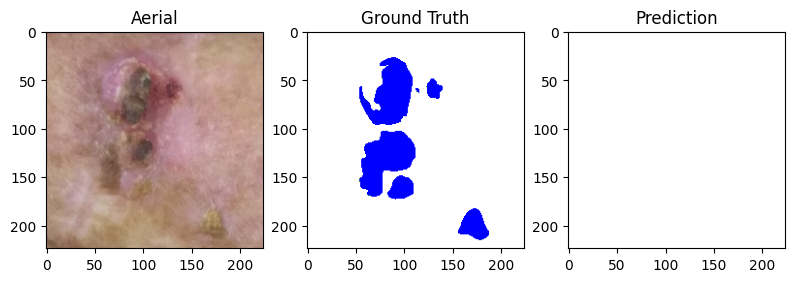

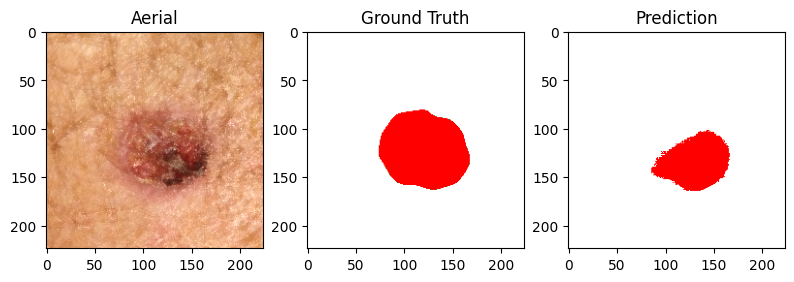

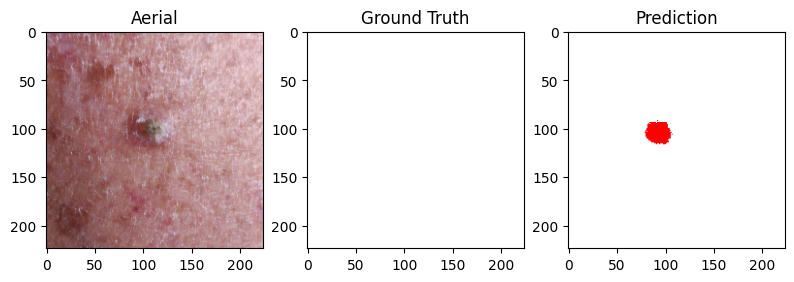

In [ ]:
for index, row in tqdm(testing_data.reset_index().sample(n=30).iterrows()):
    # extract test input image
    test_img = load_img(images_directory+row['img_file'], target_size=(224, 224))

    # ground truth test label converted from one-hot to integer encoding
    ground_truth = np.argmax(test_Y_unet[index], axis=-1)

    # expand first dimension as U-Net requires (m, h, w, nc) input shape
    test_img_input = np.expand_dims(test_img, 0)

    # make prediction with model and remove extra dimension
    prediction = np.squeeze(u_model.predict(test_img_input, verbose=0))

    # convert softmax probabilities to integer values
    predicted_img = np.argmax(prediction, axis=-1)

    # convert integer encoding to rgb values
    rgb_image = rgb_encode_mask(predicted_img)
    rgb_ground_truth = rgb_encode_mask(ground_truth)

    # visualize model predictions
    display_images(
        [test_img, rgb_ground_truth, rgb_image],
        rows=1, titles=['Aerial', 'Ground Truth', 'Prediction']
    )

## References
- [1] Pacheco, Andre G. C.; Lima, Gustavo R.; Salomão, Amanda S.; Krohling, Breno; Biral, Igor P.; de Angelo, Gabriel G. ; Alves Jr, Fábio  C. R. ; Esgario, José G. M.; Simora, Alana C. ; Castro, Pedro B. C. ; Rodrigues, Felipe B.; Frasson, Patricia H. L. ; Krohling, Renato A.; Knidel, Helder ; Santos, Maria C. S. ; Espírito Santo, Rachel B.; Macedo, Telma L. S. G.; Canuto, Tania R. P. ; de Barros, Luíz F. S. (2020), “PAD-UFES-20: a skin lesion dataset composed of patient data and clinical images collected from smartphones”, Mendeley Data, V1, doi: 10.17632/zr7vgbcyr2.1